# **Pongamos las manos en los Datos!(Let's get our hands on the data)**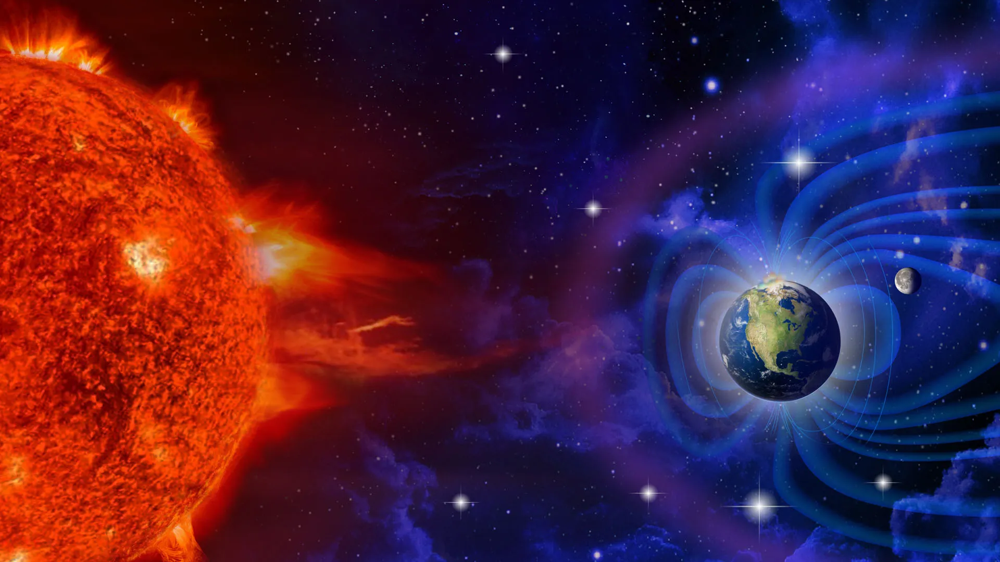


En éste Notebook Podras visualizar algunas de las variables mas importantes a la hora de comprender el clima solar.
Los datos son proporcionados gracias a instrumentos de medicion de Satelites como el SDO y el DSCORV (Ubicado en un punto estrategico entre la tierra y el sol conocido como el punto Lgarange 1 L1)

In this Notebook you can visualize some of the most important variables when it comes to understanding solar climate.
The data is provided thanks to satellite measurement instruments such as the SDO and the DSCORV (Located at a strategic point between the earth and the sun known as the Lgarange 1 L1 point)


---



En las siguientes celdas del notebook se incluye código necesario para el procesamiento de los Datos previa visualización.

The following cells of the notebook include code necessary for processing the Data prior to viewing.


#Code Necessary

In [ ]:
!pip install pandas plotly


In [2]:
import pandas as pd
import numpy as np

# Load the CSV file (make sure the path is correct if you're running this in Colab)
df = pd.read_csv('datosFormateados.csv')

# Display the first few rows
df.head()


,Date,Hour,Source,Bt-med,Bt-min,Bt-max,Bx-med,Bx-min,Bx-max,By-med,...,Theta-max,Dens-med,Dens-min,Dens-max,Speed-med,Speed-min,Speed-max,Temp-med,Temp-min,Temp-max
0,11/1/2023,12:00:00,1,4.01,3.41,4.88,-1.66,-3.81,0.27,2.15,...,60.24,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999,-99999,-99999
1,11/1/2023,18:00:00,1,3.23,2.55,3.80,-0.77,-2.84,1.71,2.30,...,56.06,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999,-99999,-99999
2,11/2/2023,0:00:00,1,3.45,2.22,4.30,-1.87,-3.94,1.02,2.05,...,76.54,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999,-99999,-99999
3,11/2/2023,6:00:00,1,2.98,2.10,3.44,-1.05,-2.67,2.13,2.27,...,56.21,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999,-99999,-99999
4,11/2/2023,12:00:00,1,3.37,2.98,3.70,-2.68,-3.49,-1.05,0.50,...,20.59,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999.0,-99999,-99999,-99999


In [3]:
# Replace -99999 values with NaN
df.replace(-99999, np.nan, inplace=True)

# Merge 'Date' and 'Hour' columns into a 'Timestamp'
df['Timestamp'] = pd.to_datetime(df['Date'] + ' ' + df['Hour'])

# Drop the 'Date' and 'Hour' columns (now that we have Timestamp)
df.drop(['Date', 'Hour'], axis=1, inplace=True)

# Display the cleaned data
df.head()


,Source,Bt-med,Bt-min,Bt-max,Bx-med,Bx-min,Bx-max,By-med,By-min,By-max,...,Dens-med,Dens-min,Dens-max,Speed-med,Speed-min,Speed-max,Temp-med,Temp-min,Temp-max,Timestamp
0,1,4.01,3.41,4.88,-1.66,-3.81,0.27,2.15,-2.41,3.88,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-11-01 12:00:00
1,1,3.23,2.55,3.80,-0.77,-2.84,1.71,2.30,-1.04,3.32,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-11-01 18:00:00
2,1,3.45,2.22,4.30,-1.87,-3.94,1.02,2.05,-1.32,3.31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-11-02 00:00:00
3,1,2.98,2.10,3.44,-1.05,-2.67,2.13,2.27,-1.83,3.08,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-11-02 06:00:00
4,1,3.37,2.98,3.70,-2.68,-3.49,-1.05,0.50,-3.20,2.68,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-11-02 12:00:00


In [4]:
df.to_csv('cleaned_solar_wind_data.csv', index=False)

In [5]:
# Convert the Timestamp column to datetime if not already in that format
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

# Define the start and end dates for May
start_date = '2024-05-01'
end_date = '2024-05-31'

# Filter the data for the specified date range
df_may = df[(df['Timestamp'] >= start_date) & (df['Timestamp'] <= end_date)]

# Display the filtered data to verify
df_may.head()


,Source,Bt-med,Bt-min,Bt-max,Bx-med,Bx-min,Bx-max,By-med,By-min,By-max,...,Dens-med,Dens-min,Dens-max,Speed-med,Speed-min,Speed-max,Temp-med,Temp-min,Temp-max,Timestamp
726,1,13.18,12.20,13.67,1.89,-0.46,2.93,-2.55,-5.86,2.08,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-01 00:00:00
727,1,13.22,12.99,13.48,3.56,-0.52,4.87,0.59,-1.68,4.60,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-01 06:00:00
728,1,12.94,12.00,13.64,1.94,0.53,3.89,10.24,6.38,12.49,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-01 12:00:00
729,1,11.30,9.24,12.82,0.54,-3.31,3.02,10.94,7.89,12.56,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-01 18:00:00
730,1,8.02,4.64,10.27,0.43,-5.56,7.35,7.49,0.62,9.87,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-02 00:00:00


In [6]:
# Load the CSV file (make sure the path is correct if you're running this in Colab)
df2 = pd.read_csv('irradiance.csv')

# Display the first few rows
df2.head()

,Date,MEGS_B_both
0,5/30/2024 20:00,0.221072
1,5/30/2024 20:01,0.220939
2,5/30/2024 20:02,0.220652
3,5/30/2024 20:03,0.220248
4,5/30/2024 20:04,0.219911


# Visualizacion de datos (Data visualization)

#Esta celda te permite Visualizar la data del Satelite DSCORV para las Variables (This cell allows you to View the DSCORV Satellite data for the Variables):

**Bt:** La variable Bt en los datos del satélite DSCOVR representa la intensidad total del campo magnético en el viento solar, que es parte del campo magnético interplanetario (IMF). Se mide en nanoteslas (nT) y es una medida clave para predecir el clima espacial.

**Bx:** BX afecta la orientación del campo magnético en el eje x.

**By:** By afecta la orientación del campo magnético en el eje y.

**Bz:** La componente Bz (norte-sur) del campo magnético interplanetario es crucial. Si Bz es negativa, es más probable que se produzcan tormentas geomagnéticas

**Phi-mean angle:** mide el ángulo horizontal del campo magnético en el plano XY. Un angulo. Un ángulo de Phi GSM cercano a 180° a 270°, indica que el campo magnético solar tiene una orientación hacia el sur, es más probable que cause tormentas geomagnéticas y auroras debido a la mayor probabilidad de reconexión magnética. Esto crea un entorno favorable para la entrada de partículas energéticas en la magnetosfera de la Tierra.

**Theta-men angle:** representa el ángulo vertical del IMF en relación con el plano ecuatorial solar. Ayuda a describir si el IMF apunta más hacia el norte o hacia el sur (similar a Bz).

No olvidemos que este satelite se encuentra en el espacio en un punto llamado Lagrange 1 (L1), ubicado aproximadamente a 1.5 millones de kilómetros de la Tierra en dirección al Sol. Este punto es especial porque cualquier objeto que esté allí siempre tendrá una vista continua del Sol sin que la Tierra lo bloquee.
En este punto, la fuerza gravitatoria de la Tierra y el Sol se equilibran con la fuerza centrífuga del objeto en órbita, permitiendo que los satélites “floten” y se mantengan en esa posición sin requerir mucho combustible para correcciones de órbita.

---


**Bt:** The Bt variable in DSCOVR satellite data represents the total magnetic field intensity of the solar wind, which is a component of the interplanetary magnetic field (IMF). Measured in nanoteslas (nT), Bt is a key parameter for space weather forecasting.

**Bx, By, and Bz:** These components represent the projections of the magnetic field vector onto the x, y, and z axes of a Cartesian coordinate system, respectively. The z-component (Bz) is particularly important; a southward-directed Bz (negative Bz) is associated with an increased likelihood of geomagnetic storms.

**Phi-mean angle:** This angle measures the horizontal orientation of the magnetic field in the XY plane. A Phi GSM angle between 180° and 270° indicates a southward-directed magnetic field, which is favorable for magnetic reconnection and the subsequent injection of energetic particles into the Earth's magnetosphere. This configuration often leads to geomagnetic storms and auroras.

**Theta-mean angle:** The theta-mean angle represents the vertical orientation of the IMF relative to the solar equatorial plane. It provides additional information about the northward or southward orientation of the magnetic field, complementary to the Bz component.

**Note:** The DSCOVR satellite is stationed at the Sun-Earth L1 Lagrange point, approximately 1.5 million kilometers from Earth in the direction of the Sun. This location offers an uninterrupted view of the Sun and allows for continuous monitoring of the solar wind. At the L1 point, the gravitational forces of the Earth and the Sun balance the centrifugal force acting on the spacecraft, allowing it to maintain a relatively stable orbit without requiring significant station-keeping maneuvers.

In [8]:
# Create a dropdown for selecting variables to plot
import plotly.graph_objs as go
dropdown_fig = go.Figure()

# Add all variables to the figure but hide them by default
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bt-med'], name='Bt-med', visible=True))
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bz-med'], name='Bx-med', visible=False))
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['By-med'], name='By-med', visible=False))
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bz-med'], name='Bz-med', visible=False))
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Phi-mean'], name='Phi-mean', visible=False))
dropdown_fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Theta-med'], name='Theta-med', visible=False))


# Update layout with a dropdown menu
dropdown_fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list([
                dict(label="Bt-med", method="update", args=[{"visible": [True, False, False, False, False, False]}]),
                dict(label="Bx-med", method="update", args=[{"visible": [False, True, False, False, False, False]}]),
                dict(label="By-med", method="update", args=[{"visible": [False, False, True, False, False, False]}]),
                dict(label="Bz-med", method="update", args=[{"visible": [False, False, False, True, False, False]}]),
                dict(label="phi-mean", method="update", args=[{"visible": [False, False, False, False, True, False]}]),
                dict(label="Theta-med", method="update", args=[{"visible": [False, False, False, False, False, True]}]),
            ]),
        )
    ]
)

# Display the dropdown menu figure
dropdown_fig.show()


# En las 2 siguientes dos celdas se superponen las variables para un mejor entendimiento y analisis (In the next two cells, the variables are superimposed for a better understanding and analysis)

In [9]:
import plotly.graph_objs as go

# Create a figure object
fig = go.Figure()

# Add traces for six variables (solar wind parameters)
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bt-med'], mode='lines', name='Bt-med'))
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bx-med'], mode='lines', name='Bx-med'))
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['By-med'], mode='lines', name='By-med'))
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Bz-med'], mode='lines', name='Bz-med'))


# Customize layout with title and labels
fig.update_layout(
    title='Solar Wind Data for May 2024',
    xaxis_title='Date',
    yaxis_title='Measurement',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),  # Show the range slider for the x-axis
        type="date"
    ),
    yaxis=dict(
        title='Values'
    )
)

# Show the figure
fig.show()


In [10]:
import plotly.graph_objs as go

# Create a figure object
fig = go.Figure()

# Add a trace for the first variable (Bt-med)
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Phi-mean'], mode='lines', name='Phi-mean'))

# Add a trace for the second variable (Speed-med)
fig.add_trace(go.Scatter(x=df_may['Timestamp'], y=df_may['Theta-med'], mode='lines', name='Theta-med'))

# Customize layout with title, labels, and range selector
fig.update_layout(
    title='Solar Wind Data: Phi and Theta angles for May 2024',
    xaxis_title='Date',
    yaxis_title='Values',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),  # Enable the range slider for the x-axis
        type="date"
    )
)

# Display the figure
fig.show()



# Como puedes observar, la mayor actividad en mayo de 2024 fue aproximadamente entre el 9 y 12 de mayo. (As you can see, the highest activity in May 2024 was approximately between May 9 and 12)

En las siguientes celdas puedes observar timelapse de fechas 10 y 11 de mayo que contienen datos de:

**AIA 171**
El Atmospheric Imaging Assembly (AIA) en el Solar Dynamics Observatory (SDO) tiene un canal que opera en una longitud de onda de 171 Ångstroms. Esta longitud de onda es particularmente sensible a la radiación del hierro (Fe IX) en la atmósfera solar.
Mediciones: AIA 171 mide principalmente la corona solar y está diseñado para observar la estructura y dinámica del plasma en esta región. Este canal proporciona imágenes de la temperatura solar, especialmente en el rango de 1 a 2 millones de grados Kelvin, permitiendo la observación de características como burbujas de plasma y circuitos magnéticos.
Importancia: Las imágenes de AIA 171 son cruciales para el estudio de la actividad solar, como las erupciones solares y las eyecciones de masa coronal (CMEs), y ayudan a predecir el clima espacial.

**HMI (Helioseismic and Magnetic Imager)**
Descripción: El HMI también se encuentra en el SDO y tiene dos principales funciones: medir el campo magnético de la superficie solar y realizar helioseismología para estudiar las oscilaciones del Sol.

**Mediciones:**

**Campo Magnético:** HMI mide el campo magnético en la superficie solar utilizando imágenes en el espectro de luz visible. Esto ayuda a identificar características magnéticas, como manchas solares y burbujas magnéticas.
Oscilaciones: También observa las oscilaciones solares, que proporcionan información sobre la estructura interna del Sol y su dinámica.
Importancia: Las mediciones del HMI son fundamentales para comprender la actividad solar y su relación con los eventos de espacio, así como para mejorar las predicciones sobre el clima espacial.


---
In the following cells you can see timelapse of dates May 10 and 11 that contain data from:

**AIA 171**
 The Atmospheric Imaging Assembly (AIA) at the Solar Dynamics Observatory (SDO) has a channel that operates at a wavelength of 171 Ångstroms. This wavelength is particularly sensitive to radiation from iron (Fe IX) in the solar atmosphere. Measurements: AIA 171 primarily measures the solar corona and is designed to observe the structure and dynamics of plasma in this region. This channel provides images of solar temperature, especially in the range of 1 to 2 million degrees Kelvin, allowing the observation of features such as plasma bubbles and magnetic circuits. Significance: Images from AIA 171 are crucial for the study of solar activity, such as solar flares and coronal mass ejections (CMEs), and help predict space weather.

**HMI (Helioseismic and Magnetic Imager) Description:** The HMI is also located in the SDO and has two main functions: measuring the magnetic field of the solar surface and performing helioseismology to study the Sun's oscillations.

**Measurements:**

**Magnetic Field:** HMI measures the magnetic field on the solar surface using imaging in the visible light spectrum. This helps identify magnetic features, such as sunspots and magnetic bubbles. Oscillations: It also observes solar oscillations, which provide information about the internal structure of the Sun and its dynamics. Importance: HMI measurements are essential for understanding solar activity and its relationship to space events, as well as improving predictions of space weather.




In [20]:
#from google.colab import drive
from IPython.display import Video

# Montar tu Google Drive
#drive.mount('/content/drive')

# Especificar la ruta completa del video en tu Google Drive
video_path = '/content/manchas.mp4'

# Mostrar el video
Video(video_path, embed=True)

In [22]:
#from google.colab import drive
from IPython.display import Video

# Montar tu Google Drive
#drive.mount('/content/drive')

# Especificar la ruta completa del video en tu Google Drive
video_path = '/content/composision.mp4'

# Mostrar el video
Video(video_path, embed=True)

# En la siguiente celda puedes observar Valores del indice Kp captados por el satelite DSCORV en mayo de 2024. Recuerda que un valor por encima de 5 indica mayor actividad geomagnetica y mayor probabilidad de ver auroras boreales en latitudes mas bajas. Se registraron valores de 9!


---
In the following cell you can see Kp index values ​​captured by the DSCORV satellite in May 2024. Remember that a value above 5 indicates greater geomagnetic activity and a greater probability of seeing the northern lights at lower latitudes. Values ​​of 9 were recorded!




In [15]:
#from google.colab import drive
from IPython.display import Video

# Montar tu Google Drive
#drive.mount('/content/drive')

# Especificar la ruta completa del video en tu Google Drive
video_path = '/content/IndiceKP.mp4'

# Mostrar el video
Video(video_path, embed=True)

#En esta ultima celda se puede ver el valor de irradiacion solar medida en mW/m^2, los datos fueron obtenidos del instrumento EVE de la sonda SDO.
EVE mide la radiación solar en el espectro de ultravioleta extremo (EUV). Esta radiación es crucial para entender la dinámica del Sol y su impacto en el clima espacial, ya que la radiación EUV puede influir en la atmósfera superior de la Tierra y en sistemas tecnológicos, como los satélites y las comunicaciones.


---

In this last cell you can see the value of solar irradiation measured in mW/m^2, the data were obtained from the EVE instrument of the SDO probe.
EVE measures solar radiation in the extreme ultraviolet (EUV) spectrum. This radiation is crucial to understanding the dynamics of the Sun and its impact on space weather, since EUV radiation can influence the Earth's upper atmosphere and technological systems, such as satellites and communications.

In [19]:
import plotly.express as px
#import pandas as pd

fig = px.line(df2, x='Date', y='MEGS_B_both', title='Gráfico Interactivo')
fig.show()

Osbserva que los valores mas altos tambien ocuerrieron entre el 9 y 12 de mayo (Note that the highest values ​​also occurred between May 9 and 12)